In [23]:
import os
import cv2
import numpy as np
from shutil import copy2
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import normalize
from insightface.app import FaceAnalysis
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, SpectralClustering, AffinityPropagation
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
import matplotlib.pyplot as plt

from ultralytics import YOLO

In [3]:
app = FaceAnalysis(name='buffalo_l', providers=['CPUExecutionProvider'])
app.prepare(ctx_id=0)  # use -1 if you face issues with ctx_id

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_

In [24]:
yolo_model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 10.8MB/s]


In [31]:
def extract_person_attributes(crop):
    # You can extend this to classify gender, glasses, etc.
    # For now, just get average color as in your earlier code
    if crop.size > 0:
        avg_color = crop.mean(axis=(0, 1))
    else:
        avg_color = np.array([0, 0, 0])
    return {'avg_color_bgr': avg_color}

def dominant_color(img, k=3):
    # Extract dominant color using k-means
    data = img.reshape((-1, 3))
    data = np.float32(data)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    _, labels, centers = cv2.kmeans(data, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    counts = np.bincount(labels.flatten())
    dominant = centers[np.argmax(counts)]
    return dominant.astype(int).tolist()

def extract_features_yolo(img, yolo_model):
    results = yolo_model(img)
    detected_objects = []
    for r in results:
        boxes = r.boxes.xyxy.cpu().numpy()
        classes = r.boxes.cls.cpu().numpy()
        for i, cls_id in enumerate(classes):
            class_name = yolo_model.model.names[int(cls_id)]
            x1, y1, x2, y2 = boxes[i].astype(int)
            crop = img[y1:y2, x1:x2]

            if class_name == 'person':
                attrs = extract_person_attributes(crop)
                detected_objects.append({'class': 'person', **attrs})
            else:
                color = dominant_color(crop, k=3)
                detected_objects.append({'class': class_name, 'color': color})
    return detected_objects


In [25]:
image_folder = 'images'
image_data = []  # to store {img_path, img, faces, embeddings}

for img_name in os.listdir(image_folder):
    img_path = os.path.join(image_folder, img_name)
    img = cv2.imread(img_path)
    if img is None:
        continue

    faces = app.get(img)
    if not faces:
        continue

    embeddings = [face.embedding for face in faces]
    
    
    # YOLO
    results = yolo_model(img)

    person_attributes = []
    for r in results:
        boxes = r.boxes.xyxy.cpu().numpy()
        classes = r.boxes.cls.cpu().numpy()
        # For COCO, class 0 = person
        for i, cls_id in enumerate(classes):
            if cls_id == 0:  # person detected
                x1, y1, x2, y2 = boxes[i].astype(int)
                person_crop = img[y1:y2, x1:x2]

                # Basic attribute example: get average clothing color (BGR)
                if person_crop.size > 0:
                    avg_color = person_crop.mean(axis=(0,1))  # Average color of detected person box
                else:
                    avg_color = np.array([0,0,0])

                person_attributes.append({
                    'bbox': (x1, y1, x2, y2),
                    'avg_color_bgr': avg_color,
                    # You can extend here with other attributes like glasses/gender classifiers
                })
    
    
    # Append all info to image_data list
    image_data.append({
        'img_path': img_path,
        'img': img,
        'faces': faces,
        'embeddings': embeddings,
        'person_attributes': person_attributes  # store detected attributes here
    })

print(f"Processed {len(image_data)} images with faces detected and person attributes extracted.")



0: 480x640 4 persons, 85.1ms
Speed: 4.2ms preprocess, 85.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)

0: 640x640 9 persons, 154.4ms
Speed: 8.6ms preprocess, 154.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x384 5 persons, 1 cell phone, 112.9ms
Speed: 3.1ms preprocess, 112.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 288x640 9 persons, 83.5ms
Speed: 1.4ms preprocess, 83.5ms inference, 0.9ms postprocess per image at shape (1, 3, 288, 640)

0: 640x288 2 persons, 71.4ms
Speed: 1.8ms preprocess, 71.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 288)

0: 384x640 7 persons, 77.8ms
Speed: 1.5ms preprocess, 77.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 8 persons, 96.3ms
Speed: 1.9ms preprocess, 96.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 288x640 18 persons, 80.1ms
Speed: 2.3ms preprocess, 80.1ms inference, 1.3ms postprocess p

In [5]:
# Flatten all embeddings
all_embeddings = []
for data in image_data:
    all_embeddings.extend(data['embeddings'])

X = np.array(all_embeddings)
X_norm = normalize(X, norm="l2")

In [6]:
# Reduce to 50D with PCA only
pca = PCA(n_components=75, random_state=42)
X_pca = pca.fit_transform(X_norm)

# Use X_pca for clustering
X_final = X_pca

print(f"PCA explained variance ratio sum: {pca.explained_variance_ratio_.sum():.2f}")

PCA explained variance ratio sum: 0.84


In [7]:
# Store results for comparison
cluster_algorithms = []

# Agglomerative Clustering
agg = AgglomerativeClustering(n_clusters=20, metric='cosine', linkage='average')
agg_labels = agg.fit_predict(X_final)
agg_silhouette = silhouette_score(X_final, agg_labels, metric='cosine')
cluster_algorithms.append(('Agglomerative', agg_labels, agg_silhouette))


# Spectral Clustering
spec = SpectralClustering(n_clusters=20, affinity='nearest_neighbors', random_state=42)
spec_labels = spec.fit_predict(X_final)
spec_silhouette = silhouette_score(X_final, spec_labels, metric='cosine')
cluster_algorithms.append(('Spectral', spec_labels, spec_silhouette))

# Affinity Propagation (no need to specify k)
aff = AffinityPropagation(random_state=42)
aff_labels = aff.fit_predict(X_final)
aff_silhouette = silhouette_score(X_final, aff_labels, metric='cosine')
cluster_algorithms.append(('AffinityPropagation', aff_labels, aff_silhouette))

# Show results
print("\n=== Clustering Algorithms Comparison ===")
for name, _, score in cluster_algorithms:
    print(f"{name:20s} → Silhouette Score: {score:.3f}")



=== Clustering Algorithms Comparison ===
Agglomerative        → Silhouette Score: 0.285
Spectral             → Silhouette Score: 0.261
AffinityPropagation  → Silhouette Score: 0.374


In [8]:
# Define fine-grained grid of parameters to try
eps_values = np.arange(0.3, 0.6, 0.025)       # eps from 0.3 to 0.575 step 0.025
min_samples_values = range(2, 7)               # min_samples from 2 to 6
metrics = ['cosine']                           # cosine metric usually best for embeddings

results = []

print("=== DBSCAN Hyperparameter Tuning on PCA embeddings ===")

for metric in metrics:
    for eps in eps_values:
        for min_samples in min_samples_values:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric=metric)
            labels = dbscan.fit_predict(X_final)

            n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
            n_outliers = np.sum(labels == -1)

            if n_clusters > 1:
                sil_score = silhouette_score(X_final, labels, metric=metric)
            else:
                sil_score = -1  # invalid silhouette score if <= 1 cluster

            results.append({
                'eps': eps,
                'min_samples': min_samples,
                'metric': metric,
                'silhouette': sil_score,
                'clusters': n_clusters,
                'outliers': n_outliers
            })

            print(f"eps={eps:.3f}, min_samples={min_samples}, metric={metric} → Clusters={n_clusters}, Outliers={n_outliers}, Silhouette={sil_score:.3f}")

# Sort results by silhouette score descending
results_sorted = sorted(results, key=lambda x: x['silhouette'], reverse=True)

print("\n=== Top 5 DBSCAN parameter sets by Silhouette Score ===")
for r in results_sorted[:5]:
    print(r)


=== DBSCAN Hyperparameter Tuning on PCA embeddings ===
eps=0.300, min_samples=2, metric=cosine → Clusters=30, Outliers=93, Silhouette=0.235
eps=0.300, min_samples=3, metric=cosine → Clusters=12, Outliers=129, Silhouette=0.172
eps=0.300, min_samples=4, metric=cosine → Clusters=8, Outliers=141, Silhouette=0.148
eps=0.300, min_samples=5, metric=cosine → Clusters=6, Outliers=149, Silhouette=0.140
eps=0.300, min_samples=6, metric=cosine → Clusters=5, Outliers=156, Silhouette=0.124
eps=0.325, min_samples=2, metric=cosine → Clusters=32, Outliers=85, Silhouette=0.265
eps=0.325, min_samples=3, metric=cosine → Clusters=12, Outliers=125, Silhouette=0.190
eps=0.325, min_samples=4, metric=cosine → Clusters=8, Outliers=137, Silhouette=0.166
eps=0.325, min_samples=5, metric=cosine → Clusters=7, Outliers=141, Silhouette=0.166
eps=0.325, min_samples=6, metric=cosine → Clusters=5, Outliers=153, Silhouette=0.142
eps=0.350, min_samples=2, metric=cosine → Clusters=29, Outliers=81, Silhouette=0.317
eps=0.35

In [9]:
# Add best DBSCAN result to algorithm comparison
best_dbscan_result = results_sorted[0]
dbscan = DBSCAN(
    eps=best_dbscan_result['eps'],
    min_samples=best_dbscan_result['min_samples'],
    metric=best_dbscan_result['metric']
)
dbscan_labels = dbscan.fit_predict(X_final)
dbscan_sil = silhouette_score(X_final, dbscan_labels, metric='cosine')

cluster_algorithms.append(('DBSCAN', dbscan_labels, dbscan_sil))


# Pick the algorithm with the highest silhouette score
best_name, best_labels, best_score = max(cluster_algorithms, key=lambda x: x[2])
print(f"\n✅ Using {best_name} clustering with silhouette score {best_score:.3f}")

# Use best labels in the rest of the pipeline
labels = best_labels


✅ Using DBSCAN clustering with silhouette score 0.377


In [10]:
# Filter out outliers (e.g., label = -1)
valid_mask = labels != -1
X_valid = X_final[valid_mask]
labels_valid = labels[valid_mask]

# Only compute if more than 1 cluster remains
if len(set(labels_valid)) > 1:
    dbi = davies_bouldin_score(X_valid, labels_valid)
    chi = calinski_harabasz_score(X_valid, labels_valid)

    print("\n📊 Quantitative Evaluation Metrics:")
    print(f"Silhouette Score:         {best_score:.3f}")
    print(f"Davies-Bouldin Index:     {dbi:.3f}  (lower is better)")
    print(f"Calinski-Harabasz Index:  {chi:.3f}  (higher is better)")
else:
    print("\n⚠️ Not enough valid clusters to compute DBI/CHI.")



📊 Quantitative Evaluation Metrics:
Silhouette Score:         0.377
Davies-Bouldin Index:     1.114  (lower is better)
Calinski-Harabasz Index:  10.388  (higher is better)


In [11]:
idx = 0
for data in image_data:
    n = len(data['embeddings'])
    data['labels'] = labels[idx:idx+n]
    idx += n

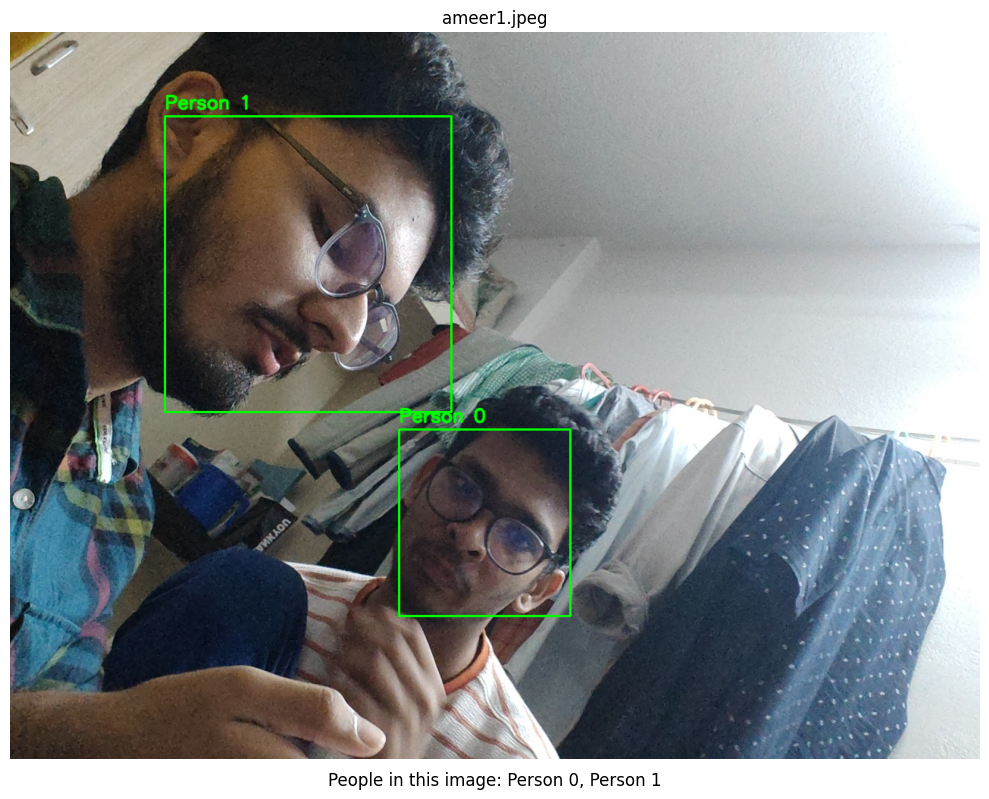

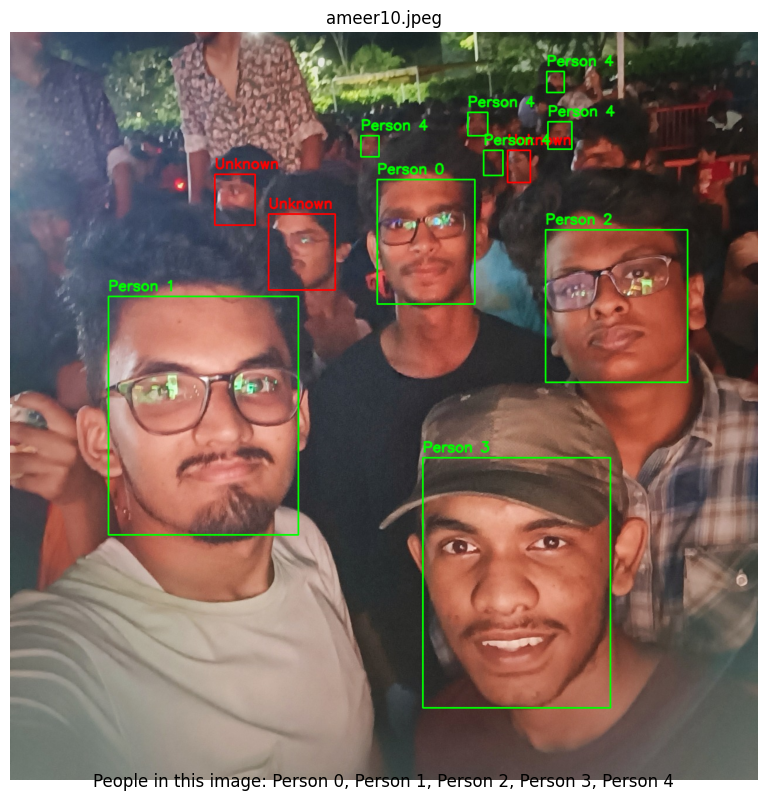

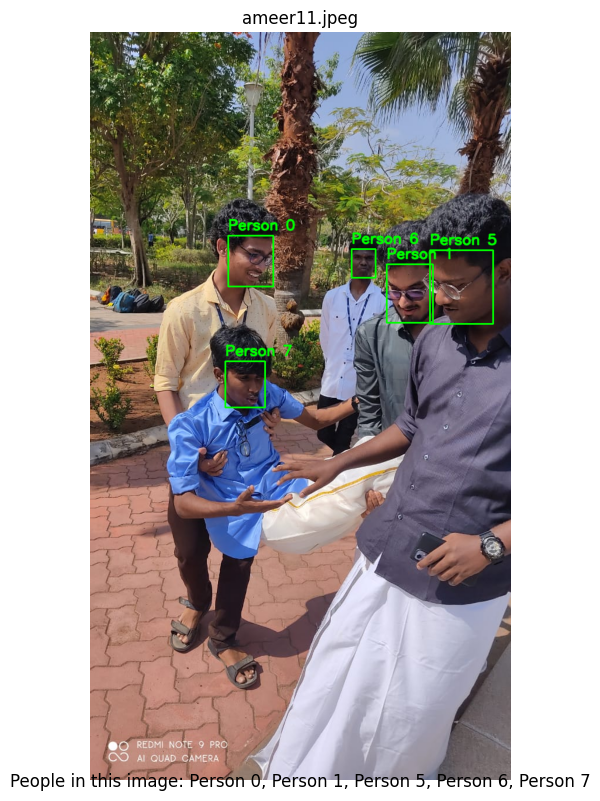

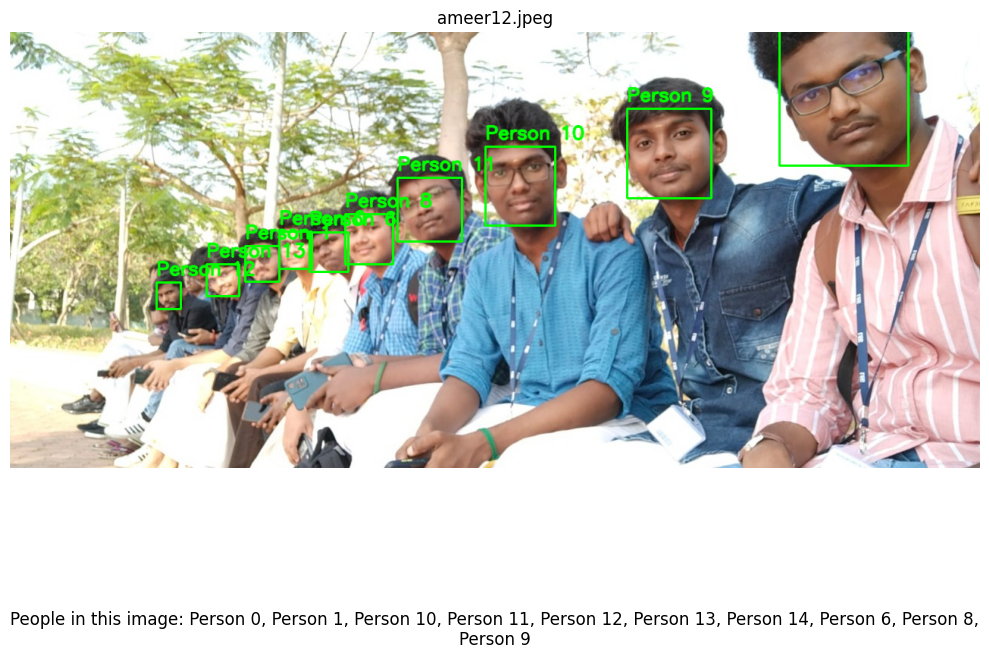

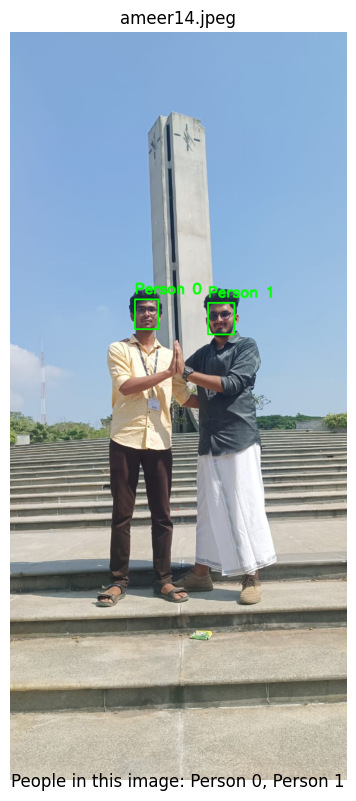

...

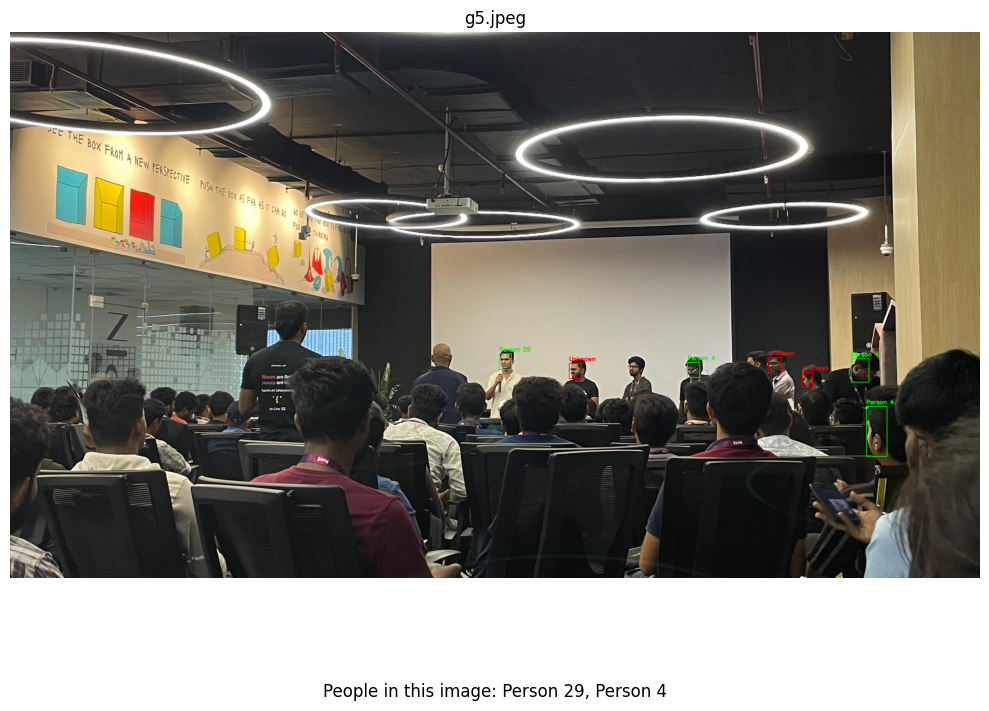

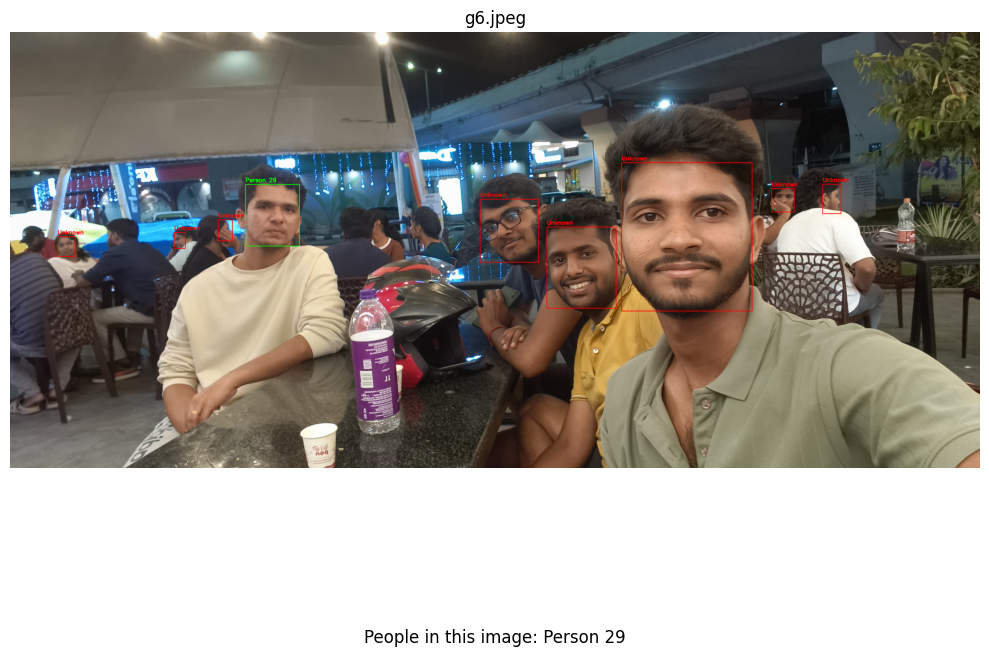

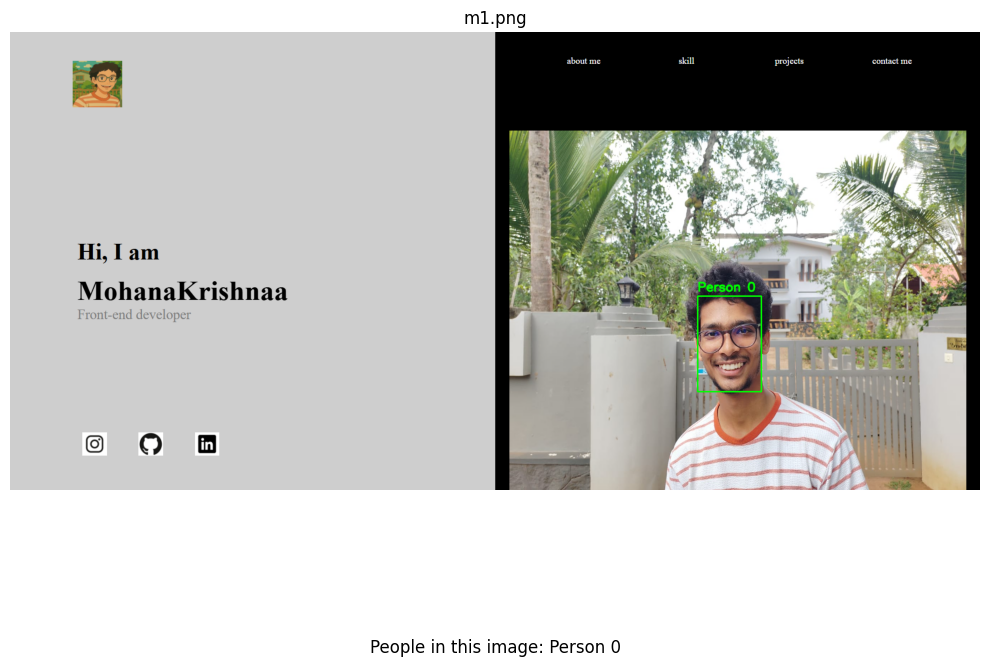

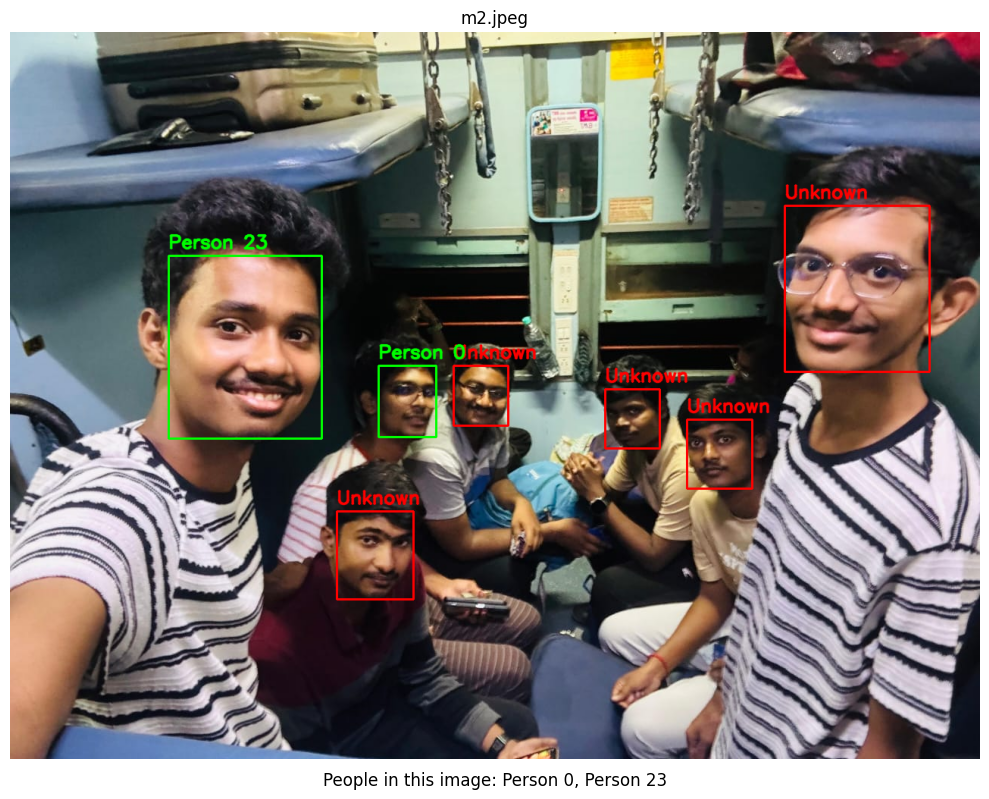

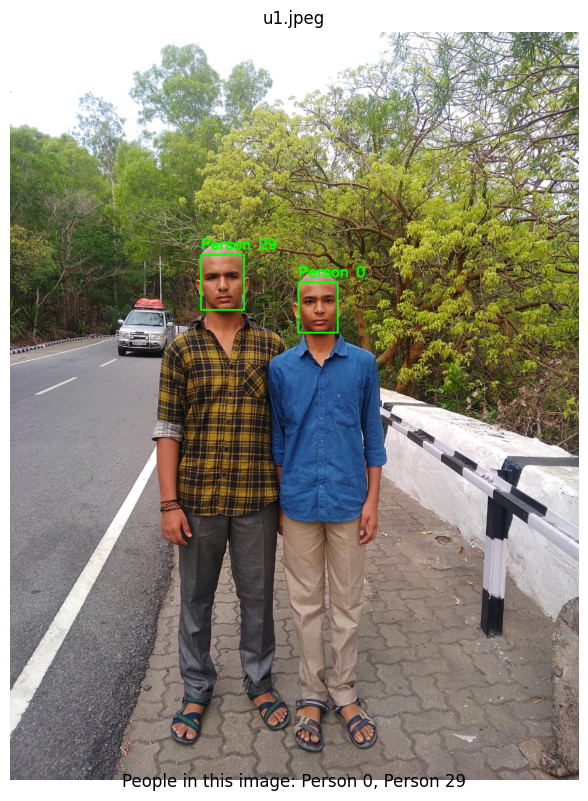

In [12]:
def draw_faces(img, faces, labels):
    img_disp = img.copy()
    for face, label in zip(faces, labels):
        bbox = face.bbox.astype(int)
        x1, y1, x2, y2 = bbox[0], bbox[1], bbox[2], bbox[3]

        # Color & text
        color = (0, 255, 0) if label != -1 else (0, 0, 255)
        text = f"Person {label}" if label != -1 else "Unknown"

        # Draw box
        cv2.rectangle(img_disp, (x1, y1), (x2, y2), color, 2)
        cv2.putText(img_disp, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.8, color, 2, cv2.LINE_AA)
    return img_disp

# Display labeled faces
for data in image_data:
    img_labeled = draw_faces(data['img'], data['faces'], data['labels'])

    persons_in_img = sorted(set(f"Person {label}" for label in data['labels'] if label != -1))
    persons_text = "People in this image: " + (", ".join(persons_in_img) if persons_in_img else "Unknown")

    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(img_labeled, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(os.path.basename(data['img_path']))
    plt.figtext(0.5, 0.01, persons_text, ha="center", fontsize=12, wrap=True)
    plt.tight_layout()
    plt.show()

In [13]:
person_to_images = {}

for data in image_data:
    for label in data['labels']:
        if label == -1:
            continue
        person_key = f"Person {label}"
        if person_key not in person_to_images:
            person_to_images[person_key] = []
        if data['img_path'] not in person_to_images[person_key]:
            person_to_images[person_key].append(data['img_path'])

# Print the dictionary
for key, value in person_to_images.items():
    print(f"{key} - {value}")

Person 0 - ['images\\ameer1.jpeg', 'images\\ameer10.jpeg', 'images\\ameer11.jpeg', 'images\\ameer12.jpeg', 'images\\ameer14.jpeg', 'images\\ameer15.jpeg', 'images\\ameer16.jpeg', 'images\\ameer18.jpeg', 'images\\ameer19.jpeg', 'images\\ameer2.jpeg', 'images\\ameer20.jpeg', 'images\\ameer21.jpeg', 'images\\ameer22.jpeg', 'images\\ameer23.jpeg', 'images\\ameer24.jpeg', 'images\\ameer25.jpeg', 'images\\ameer26.jpeg', 'images\\ameer6.jpeg', 'images\\ameer8.jpeg', 'images\\ameer9.jpeg', 'images\\m1.png', 'images\\m2.jpeg', 'images\\u1.jpeg']
Person 1 - ['images\\ameer1.jpeg', 'images\\ameer10.jpeg', 'images\\ameer11.jpeg', 'images\\ameer12.jpeg', 'images\\ameer14.jpeg', 'images\\ameer15.jpeg', 'images\\ameer16.jpeg', 'images\\ameer18.jpeg', 'images\\ameer19.jpeg', 'images\\ameer2.jpeg', 'images\\ameer20.jpeg', 'images\\ameer21.jpeg', 'images\\ameer22.jpeg', 'images\\ameer23.jpeg', 'images\\ameer24.jpeg', 'images\\ameer25.jpeg', 'images\\ameer26.jpeg', 'images\\ameer6.jpeg', 'images\\ameer8.

In [16]:
from sklearn.metrics.pairwise import cosine_similarity

def display_matched_images(query_img_path, image_data, X_final, labels, threshold=0.55, top_k=20):
    """
    Given a query image, find and display all dataset images where the same person appears,
    sorted by similarity with similarity score shown.
    """

    query_img = cv2.imread(query_img_path)
    if query_img is None:
        print("❌ Failed to load query image.")
        return

    query_faces = app.get(query_img)
    if not query_faces:
        print("❌ No face detected in the query image.")
        return

    query_embedding = query_faces[0].embedding.reshape(1, -1)
    query_embedding_norm = normalize(query_embedding, norm="l2")
    query_pca = pca.transform(query_embedding_norm)

    # Similarity with all embeddings
    similarities = cosine_similarity(query_pca, X_final)[0]

    # Get sorted indices by similarity
    sorted_indices = np.argsort(similarities)[::-1]  # descending order

    matched_info = []
    used_paths = set()

    for idx in sorted_indices:
        sim = similarities[idx]
        if sim < threshold:
            break  # stop if below threshold

        label = labels[idx]

        # Find the image that contains this label
        for data in image_data:
            if data['img_path'] in used_paths:
                continue
            if label in data['labels']:
                matched_info.append((data['img_path'], sim))
                used_paths.add(data['img_path'])
                break  # move to next idx

        if len(matched_info) >= top_k:
            break

    if not matched_info:
        print("⚠️ No sufficiently similar faces found.")
        return

    # Display the images
    cols = 4
    rows = (len(matched_info) + cols - 1) // cols
    plt.figure(figsize=(16, 4 * rows))

    for i, (img_path, sim) in enumerate(matched_info):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Similarity: {sim*100:.2f}%\n{os.path.basename(img_path)}", fontsize=10)

    plt.tight_layout()
    plt.show()

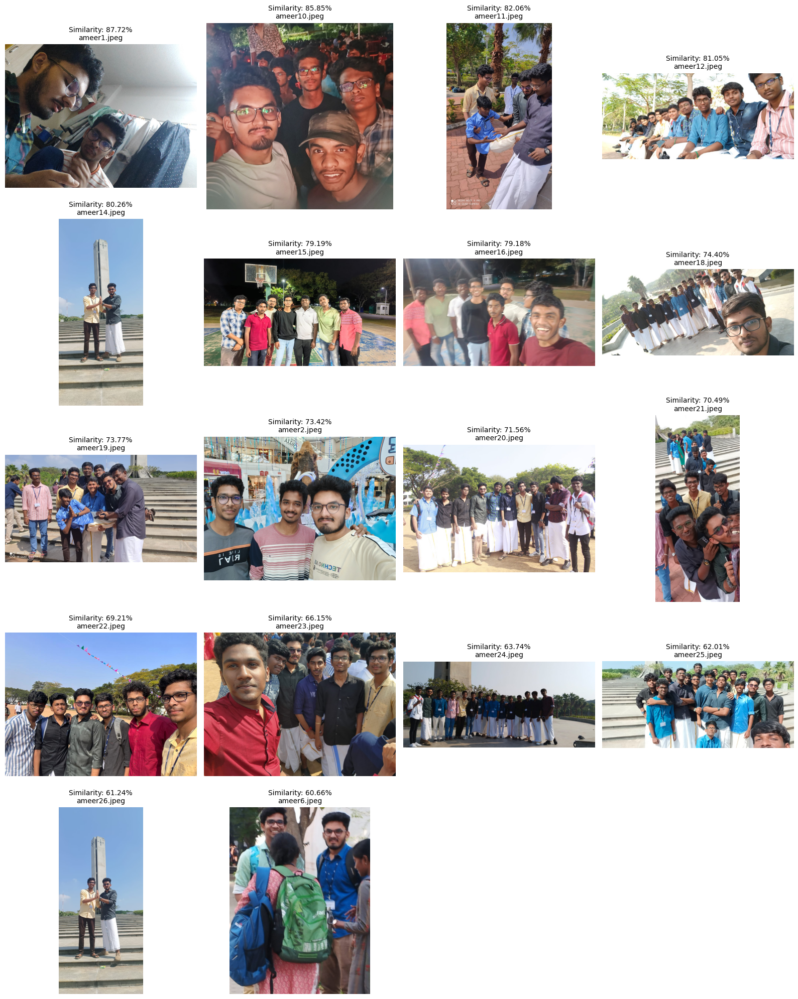

In [17]:
query_image_path = "test5.jpeg"  # Replace with your input
display_matched_images(query_image_path, image_data, X_final, labels, threshold=0.55)

In [26]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

def display_images_by_prompt(prompt, image_data, person_to_images, color_threshold=100):
    """
    Display images matching the user prompt.
    Supports:
      - 'Person X' (e.g. 'Person 3')
      - 'blue clothes' / 'red clothes' / 'green clothes' (basic color filter)
    
    Args:
      prompt: str, user input string
      image_data: list of dicts with image info & attributes
      person_to_images: dict mapping person label to list of image paths
      color_threshold: float, threshold for color matching in BGR space
    """

    prompt = prompt.lower().strip()

    matched_img_paths = set()

    if prompt.startswith("person"):
        # Example: "Person 3"
        person_key = prompt.title()  # to match keys like "Person 3"
        if person_key in person_to_images:
            matched_img_paths.update(person_to_images[person_key])
        else:
            print(f"No images found for {person_key}")

    elif "clothes" in prompt:
        # Basic color keyword detection (red, green, blue)
        color_map = {
            "red": np.array([0, 0, 255]),
            "green": np.array([0, 255, 0]),
            "blue": np.array([255, 0, 0]),
        }
        for color_name, bgr_val in color_map.items():
            if color_name in prompt:
                # Find images where any detected person's avg_color_bgr is close to this color
                for data in image_data:
                    for attr in data.get('person_attributes', []):
                        avg_color = attr['avg_color_bgr']
                        dist = np.linalg.norm(avg_color - bgr_val)
                        if dist < color_threshold:
                            matched_img_paths.add(data['img_path'])
                break

    else:
        print("Prompt not recognized. Please try 'Person X' or '<color> clothes'.")

    if not matched_img_paths:
        print("No matching images found.")
        return

    # Display images
    cols = 4
    rows = (len(matched_img_paths) + cols - 1) // cols
    plt.figure(figsize=(16, 4 * rows))

    for i, img_path in enumerate(matched_img_paths):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(img_path.split('/')[-1], fontsize=10)

    plt.tight_layout()
    plt.show()


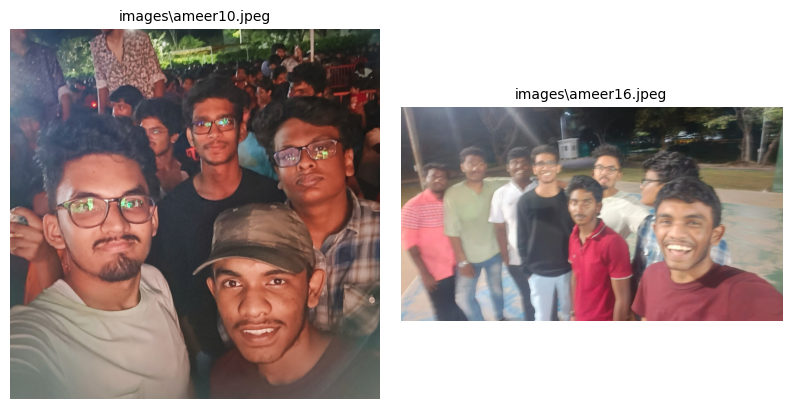

In [29]:
# Example usage - put this where you want to interactively query/display

user_input = "Person 3"   # or "blue clothes"
display_images_by_prompt(user_input, image_data, person_to_images)

In [36]:
image_paths = [os.path.join(image_folder, fname) for fname in os.listdir(image_folder)]

# (2) Build image metadata
image_metadata = []
for img_path in image_paths:
    img = cv2.imread(img_path)
    objects = extract_features_yolo(img, yolo_model)
    image_metadata.append({'image_path': img_path, 'objects': objects})

# (3) Parse user prompt (very simplified example)
def parse_prompt(prompt):
    prompt = prompt.lower()
    # Naive extraction: find keywords and colors
    object_types = ['person', 'car', 'hat', 'glasses', 'man', 'woman']
    colors = ['red', 'blue', 'green', 'black', 'white']
    requested_objects = [obj for obj in object_types if obj in prompt]
    requested_colors = [col for col in colors if col in prompt]
    glasses = 'glasses' in prompt or 'sunglasses' in prompt
    gender = None
    if 'man' in prompt or 'male' in prompt:
        gender = 'male'
    elif 'woman' in prompt or 'female' in prompt:
        gender = 'female'
    return requested_objects, requested_colors, glasses, gender

# (4) Match images
def match_images(image_metadata, prompt):
    requested_objects, requested_colors, glasses_req, gender_req = parse_prompt(prompt)
    matched_images = []

    for data in image_metadata:
        for obj in data['objects']:
            if requested_objects and obj['class'] not in requested_objects:
                continue
            if requested_colors and 'color' in obj and obj['color'] not in requested_colors:
                continue
            if glasses_req and not obj.get('glasses', False):
                continue
            if gender_req and obj.get('gender') != gender_req:
                continue
            matched_images.append(data['image_path'])
            break  # one object matched is enough

    return list(set(matched_images))

def display_images(image_paths):
    import matplotlib.pyplot as plt
    import cv2
    
    cols = 4
    rows = (len(image_paths) + cols - 1) // cols
    plt.figure(figsize=(16, 9))  # Set figure size (width, height in inches)
    
    for i, path in enumerate(image_paths):
        img = cv2.imread(path)
        if img is None:
            print(f"Warning: Could not load image {path}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for plt
        
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')  # Hide axes ticks and labels
        plt.title(path.split('/')[-1])  # Show filename only in title
    
    plt.tight_layout()
    plt.show()


0: 480x640 4 persons, 100.3ms
Speed: 3.7ms preprocess, 100.3ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)

0: 640x640 9 persons, 149.7ms
Speed: 5.8ms preprocess, 149.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x384 5 persons, 1 cell phone, 91.9ms
Speed: 1.8ms preprocess, 91.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 384)

0: 288x640 9 persons, 83.5ms
Speed: 2.6ms preprocess, 83.5ms inference, 1.6ms postprocess per image at shape (1, 3, 288, 640)

0: 640x288 2 persons, 95.2ms
Speed: 2.5ms preprocess, 95.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 288)

0: 384x640 7 persons, 88.3ms
Speed: 2.4ms preprocess, 88.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 8 persons, 80.1ms
Speed: 1.7ms preprocess, 80.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 288x640 18 persons, 63.4ms
Speed: 1.4ms preprocess, 63.4ms inference, 1.2ms postprocess pe

In [37]:

# Example usage
user_prompt = "images with blue car and person with glasses"
matches = match_images(image_metadata, user_prompt)
display_images(matches)

<Figure size 1600x900 with 0 Axes>